<a href="https://colab.research.google.com/github/s134075DTU/deep_learning_project/blob/main/Copy_of_Deep_learning_img_colorization_s134075.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Colorization with U-Net and GAN

This is the main modeling file. And basically it contains most of the work I have done. You can't see some of the smaller work I have done like hyper parameter tuning. That also represent less time, and generally had little affect on the quality of the trained model.

The notebook is based on the Image colorization tutorial by Moein Shariatnia (https://github.com/moein-shariatnia/Deep-Learning/tree/main/Image%20Colorization%20Tutorial). Since I took the course last year and therefore did not know how to use pytorch, I initially started from scratch as a way to learn. I ended up making was essentially the same as what was in the tutorial. The tutorial code is more readable and flexible than mine, and therefore i began adapting from that.

The notebook is only tested on colab but should theoretically work offline if you set use_colab to false

In [ ]:
use_colab = True #set to false to use local dataset
allow_cpu = False #do we allow training using only CPU
target_epochs = 60 #how many epochs to train the models for
train_set_size = 5000

### Imports and Utility functions
Contains most of the imports and functions to visualize progress for dumb monkey brains

In [ ]:
#imports
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb
Path.ls = lambda x: list(x.iterdir())

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader


#check device
class StopExecution(Exception):
    def _render_traceback_(self):
        pass
        
if (not torch.cuda.is_available()):
  if (not allow_cpu):
    raise StopExecution

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

These functions were nor included in the explanations of the TDS article. These are just some utility functions to log the losses of our network and also visualize the results during training. So here you can check them out:

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def create_loss_meters_nodiscrim():
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_G': loss_G}


def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def show_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

def loss_meter_to_csv(loss_meter_dict):
    out = ""
    for loss_name, loss_meter in loss_meter_dict.items():
        out += "," + str(loss_meter.avg)
    return out[1:]


###Setup and Data Acquisition

I choose to store the models on my drive so that needs to be attached

In [ ]:
if(use_colab):
  from google.colab import drive
  drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#create a folder to hold the models
if(use_colab):
  Drive_path = '/content/drive/MyDrive/Model_folder'
else: 
  Drive_path = '/Model_folder'

try:
  os.mkdir(Drive_path)
except FileExistsError:
  print("Folder already exists")

Folder already exists


We get the dataset from fast AI

In [ ]:
!pip install fastai --upgrade

The following will download about 20,000 images from COCO dataset. Notice that **we are going to use only 8000 of them** for training. Also you can use any other dataset like ImageNet as long as it contains various scenes and locations.

In [ ]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

In [ ]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"
    
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 10_000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(10_000)
train_idxs = rand_idxs[:train_set_size]
val_idxs = rand_idxs[train_set_size:] 
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

5000 5000


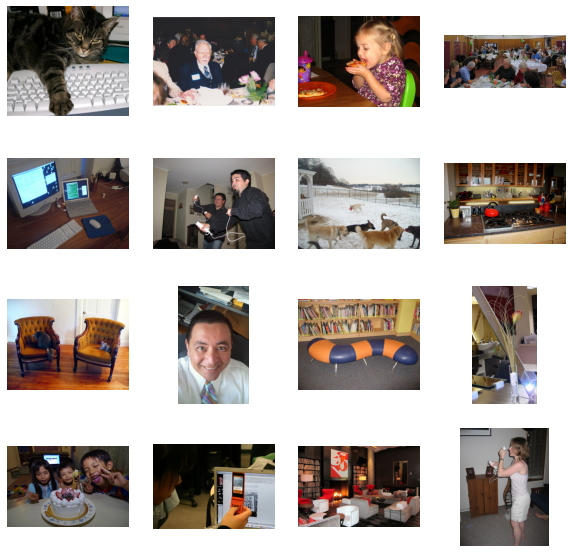

In [ ]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

###Making Datasets and DataLoaders

I hope the code is self-explanatory. I'm resizing the images and flipping horizontally (flipping only if it is training set) and then I read an RGB image, convert it to Lab color space and separate the first (grayscale) channel and the color channels as my inputs and targets for the models  respectively. Then I'm making the data loaders.

In [ ]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)
        
        self.split = split
        self.size = SIZE
        self.paths = paths
    
    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:288: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
313 313


###Generator Zoo
This section contains the definitions of the various models I Tested

In [ ]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock_pix(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock_pix(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock_pix(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock_pix(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)


#dumb net 
class Conv_net_dumb(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential( 
            nn.Conv2d(1, 64, 3,padding=1),
            nn.LeakyReLU(),

            nn.Conv2d(64, 64, 3,padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            
            nn.Conv2d(64, 128,  3,padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.Conv2d(128, 512,  3,padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(),
            
            nn.Conv2d(512, 2, 3,padding=1),
            nn.Tanh()
            )
    
    def forward(self, x):
        return self.model(x)


##########################with pixel shuffle 
class UnetBlock_pix(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            if dropout: 
              upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            else:
              upconv = nn.PixelShuffle(2)
            up = [uprelu, upconv, upnorm]

            if dropout:
              up += [nn.Dropout(0.5)]

            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet_pix(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock_pix(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock_pix(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock_pix(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock_pix(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)


class UnetBlock_more_conv(nn.Module):
  def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                innermost=False, outermost=False):
      super().__init__()
      self.outermost = outermost
      if input_c is None: input_c = nf
      downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                            stride=2, padding=1, bias=False)
      downrelu = nn.LeakyReLU(0.2, True)
      downnorm = nn.BatchNorm2d(ni)
      uprelu = nn.ReLU(True)
      upnorm = nn.BatchNorm2d(nf)
      
      if outermost:
          upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1)
          down = [downconv]
          up = [uprelu, upconv, nn.Tanh()]
          model = down + [submodule] + up
      elif innermost:
          upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False)
          down = [downrelu, downconv]
          up = [uprelu, upconv, upnorm]
          model = down + up
      else:
          up = [uprelu,nn.Conv2d(ni*2,ni*2,kernel_size = 3, padding = 1, bias = False, stride=1), uprelu , nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False),upnorm]
          down = [downrelu, downconv, downnorm]
          #up = [uprelu, upconv, upnorm]
          if dropout: up += [nn.Dropout(0.5)]
          model = down + [submodule] + up
      self.model = nn.Sequential(*model)
  
  def forward(self, x):
      if self.outermost:
          return self.model(x)
      else:
          return torch.cat([x, self.model(x)], 1)

class Unet_more_conv(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock_more_conv(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock_more_conv(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock_more_conv(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock_more_conv(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)


  
class UnetBlock_more_conv_both(nn.Module):
  def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                innermost=False, outermost=False):
      super().__init__()
      self.outermost = outermost
      if input_c is None: input_c = nf
      downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                            stride=2, padding=1, bias=False)
      downrelu = nn.LeakyReLU(0.2, True)
      downnorm = nn.BatchNorm2d(ni)
      uprelu = nn.ReLU(True)
      upnorm = nn.BatchNorm2d(nf)
      
      if outermost:
          upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1)
          down = [downconv]
          up = [uprelu, upconv, nn.Tanh()]
          model = down + [submodule] + up
      elif innermost:
          upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False)
          down = [downrelu, downconv]
          up = [uprelu, upconv, upnorm]
          model = down + up
      else:
          up = [uprelu,nn.Conv2d(ni*2,ni*2,kernel_size = 3, padding = 1, bias = False, stride=1), uprelu , nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False),upnorm]
          down = [downrelu,
                  nn.Conv2d(input_c, input_c, kernel_size=3,
                            stride=1, padding=1, bias=False),
                  nn.BatchNorm2d(input_c),
                  downrelu, 
                  downconv, 
                  downnorm]
          #up = [uprelu, upconv, upnorm]
          if dropout: up += [nn.Dropout(0.5)]
          model = down + [submodule] + up
      self.model = nn.Sequential(*model)
  
  def forward(self, x):
      if self.outermost:
          return self.model(x)
      else:
          return torch.cat([x, self.model(x)], 1)

class Unet_more_conv_both(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock_more_conv_both(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock_more_conv_both(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock_more_conv_both(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock_more_conv_both(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)



        ###########################even more conv after latent space

class UnetBlock_mega_conv(nn.Module):
  def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                innermost=False, outermost=False):
      super().__init__()
      self.outermost = outermost
      if input_c is None: input_c = nf
      downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                            stride=2, padding=1, bias=False)
      downrelu = nn.LeakyReLU(0.2, True)
      downnorm = nn.BatchNorm2d(ni)
      uprelu = nn.ReLU(True)
      upnorm = nn.BatchNorm2d(nf)
      
      if outermost:
          upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1)
          down = [downconv]
          up = [uprelu, upconv, nn.Tanh()]
          model = down + [submodule] + up
      elif innermost:
          upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False)
          down = [downrelu, downconv]
          up = [uprelu, upconv, upnorm]
          model = down + up
      else:
          up = [uprelu,
                nn.Conv2d(ni*2,ni*2,kernel_size = 3, padding = 1, bias = False, stride=1), 
                nn.BatchNorm2d(ni*2),
                uprelu,
                nn.Conv2d(ni*2,ni*2,kernel_size = 3, padding = 1, bias = False, stride=1), 
                nn.BatchNorm2d(ni*2),
                uprelu,
                nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False),
                upnorm]
          down = [downrelu,
                  nn.Conv2d(input_c, input_c, kernel_size=3,
                            stride=1, padding=1, bias=False),
                  nn.BatchNorm2d(input_c),
                  downrelu, 
                  downconv, 
                  downnorm]
          #up = [uprelu, upconv, upnorm]
          if dropout: up += [nn.Dropout(0.5)]
          model = down + [submodule] + up
      self.model = nn.Sequential(*model)
  
  def forward(self, x):
      if self.outermost:
          return self.model(x)
      else:
          return torch.cat([x, self.model(x)], 1)

class Unet_mega_conv(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock_mega_conv(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock_mega_conv(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock_mega_conv(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock_mega_conv(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

class UnetBlock_pixel_shuf_layer(nn.Module):
  def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                innermost=False, outermost=False):
      super().__init__()
      self.outermost = outermost
      if input_c is None: input_c = nf
      downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                            stride=2, padding=1, bias=False)
      downrelu = nn.LeakyReLU(0.2, True)
      downnorm = nn.BatchNorm2d(ni)
      uprelu = nn.ReLU(True)
      upnorm = nn.BatchNorm2d(nf)
      
      if outermost:
          upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1)
          down = [downconv]
          up = [uprelu, upconv, nn.Tanh()]
          model = down + [submodule] + up
      elif innermost:
          upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False)
          down = [downrelu, downconv]
          up = [uprelu, upconv, upnorm]
          model = down + up
      else:
          up = [uprelu,nn.Conv2d(ni*2,ni*2*4,kernel_size = 3, padding = 1, bias = False, stride=2), nn.BatchNorm2d(ni*2*4), uprelu, nn.PixelShuffle(2), nn.BatchNorm2d(ni*2)  , uprelu , nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                      stride=2, padding=1, bias=False),nn.BatchNorm2d(nf)]
          down = [downrelu, downconv, downnorm]
          #up = [uprelu, upconv, upnorm]
          if dropout: up += [nn.Dropout(0.5)]
          model = down + [submodule] + up
      self.model = nn.Sequential(*model)
  
  def forward(self, x):
      if self.outermost:
          return self.model(x)
      else:
          return torch.cat([x, self.model(x)], 1)

class Unet_pixel_shuf_layer(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock_pixel_shuf_layer(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock_pixel_shuf_layer(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock_pixel_shuf_layer(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock_pixel_shuf_layer(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

###Discriminator

The architecture of our discriminator is rather straight forward. This code implements a model by stacking blocks of Conv-BatchNorm-LeackyReLU to decide whether the input image is fake or real. Notice that the first and last blocks do not use normalization and the last block has no activation function (it is embedded in the loss function we will use).

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

Let's take a look at its blocks:

In [ ]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

And its output shape:

In [ ]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

We are using a "Patch" Discriminator here. Okay, what is it?! In a vanilla discriminator, the model outputs one number (a scaler) which represents how much the model thinks the input (which is the whole image) is real (or fake). In a patch discriminator, the model outputs one number for every patch of say 70 by 70 pixels of the input image and for each of them decides whether it is fake or not separately. Using such a model for the task of colorization seems reasonable to me because the local changes that the model needs to make are really important and maybe deciding on the whole image as in vanilla discriminator cannot take care of the subtleties of this task. Here, the model's output shape is 30 by 30 but it does not mean that our patches are 30 by 30. The actual patch size is obtained when you compute the receptive field of each of these 900 (30 multiplied by 30) output numbers which in our case will be 70 by 70.

### 1.5- GAN Loss

This is a handy class we can use to calculate the GAN loss of our final model. In the __init__ we decide which kind of loss we're going to use (which will be "vanilla" in our project) and register some constant tensors as the "real" and "fake" labels. Then when we call this module, it makes an appropriate tensor full of zeros or ones (according to what we need at the stage) and computes the loss.

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

### 1.x Model Initialization

In the TowardsDataScince article, I didn't explain this function. Here is our logic to initialize our models. We are going to initialize the weights of our model with a mean of 0.0 and standard deviation of 0.02 which are the proposed hyperparameters in the article:

In [ ]:
def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

### Model Zoo




This class brings together all the previous parts and implements a few methods to take care of training our complete model. Let's investigate it. 

In the __init__ we define our generator and discriminator using the previous functions and classes we defined and we also initialize them with init_model function which I didn't explain here but you can refer to my GitHub repository to see how it works. Then we define our two loss functions and the optimizers of the generator and discriminator. 

The whole work is being done in optimize method of this class. First and only once per iteration (batch of training set) we call the module's forward method and store the outputs in fake_color variable of the class. 

Then, we first train the discriminator by using backward_D method in which we feed the fake images produced by generator to the discriminator (make sure to detach them from the generator's graph so that they act as a constant to the discriminator, like normal images) and label them as fake. Then we feed a batch of real images from training set to the discriminator and label them as real. We add up the two losses for fake and real and take the average and then call the backward on the final loss. 
Now, we can train the generator. In backward_G method we feed the discriminator the fake image and try to fool it by assigning real labels to them and calculating the adversarial loss. As I mentioned earlier, we use L1 loss as well and compute the distance between the predicted two channels and the target two channels and multiply this loss by a coefficient (which is 100 in our case) to balance the two losses and then add this loss to the adversarial loss. Then we call the backward method of the loss.

In [ ]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()


##########################################version with no disciminator 

class MainModelNoDiscrim(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
      
        self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)

    
    def optimize(self):
        self.net_G.train()
        self.opt_G.zero_grad()
        self.forward()
        self.loss_G = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G.backward()
        self.opt_G.step()

##########################################
class MainModelNoDiscrim_pix(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
      
        self.net_G = init_model(Unet_pix(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)

    
    def optimize(self):
        self.net_G.train()
        self.opt_G.zero_grad()
        self.forward()
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G_L1.backward()
        self.opt_G.step()

###########################pixel shuffle for upsampling
class MainModel_pix(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, 
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet_pix(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

### 1.7- Training and results

I hope this code is self-explanatory. Every epoch takes about 4 minutes on not a powerful GPU as Nvidia P5000. So if you are using 1080Ti or higher, it will be much faster.

In [ ]:
save_every = 10 #how many epochs between saves

def train_model(model, model_name, train_dl, epochs=target_epochs, display_every=300,getDiscriminatorLoss = True):

    #check if model is in folder, if so load most trained version of the model
    start = 0
    data_name = "model_data.csv"
    dict_name = model_name + "_stdict"
    descr_len = len(dict_name) + 1

    dirs = os.listdir(Drive_path)
    model_saves = []
    for p in dirs:
      if dict_name in p:
        completed_epochs = int(p[descr_len:])
        model_saves.append((completed_epochs,p))
    
    #if we have previous saves, load them
    if model_saves:
      model_saves = sorted(model_saves, reverse=True)
      (start,model_path) = model_saves[0] 
      print(f'found {model_path} with {start} epochs')
      #load the state dict
      model.load_state_dict(torch.load(Drive_path+"/"+model_path))

    #if no saved model is found  
    else:
      print("found no model --- training from scratch")

    if start < epochs:
      print(f'Training {model_name} starting epoch {start} to epoch {epochs}')
    else:
      print(f'There already is a saved version of {model_name} with {epochs} epochs of training')
      return

    
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(start,epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        if getDiscriminatorLoss == False:
          loss_meter_dict = create_loss_meters_nodiscrim()
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                show_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs
        
        #log the loss for the epoch
        csv_entry = [str(e+1), model_name]
        if getDiscriminatorLoss == False:
          csv_entry = [str(e+1), model_name, '0','0','0','0','0']
        for loss_name, loss_meter in loss_meter_dict.items():
          csv_entry.append(str(loss_meter.avg))
        with open(Drive_path + "/" + data_name, 'a') as f:
          f.write(','.join(csv_entry))
          f.write('\n')

        if (e+1) % save_every == 0:
          #write the more trained state dict to drive
          torch.save(model.state_dict(), Drive_path +"/"+dict_name + "_" + str(e+1))


In [ ]:
#simple model, unet with no discriminator
model_no_discrim = MainModelNoDiscrim()
train_model(model_no_discrim,"MOD1_nodiscrim", train_dl, getDiscriminatorLoss=False)

In [ ]:
model = MainModel()
train_model(model,"MOD1", train_dl)

In [ ]:
model = MainModel()
train_model(model,"model1", train_dl)

model initialized with norm initialization
model initialized with norm initialization
found no model --- training from scratch
Training pix_mod starting epoch 0 to epoch 60


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 1/60
Iteration 300/313
loss_D_fake: 0.45267
loss_D_real: 0.45892
loss_D: 0.45580
loss_G_GAN: 1.62713
loss_G_L1: 10.37130
loss_G: 11.99842


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 72 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 68 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 49 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

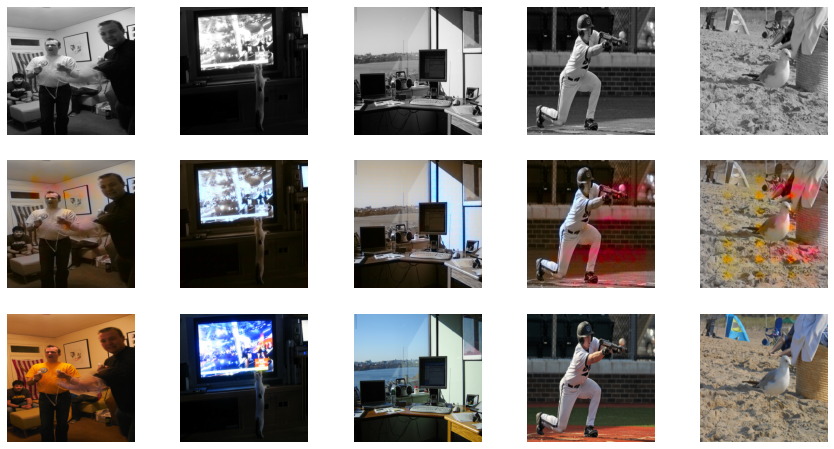

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 2/60
Iteration 300/313
loss_D_fake: 0.49713
loss_D_real: 0.51604
loss_D: 0.50659
loss_G_GAN: 1.45497
loss_G_L1: 10.70323
loss_G: 12.15820


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 67 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color d

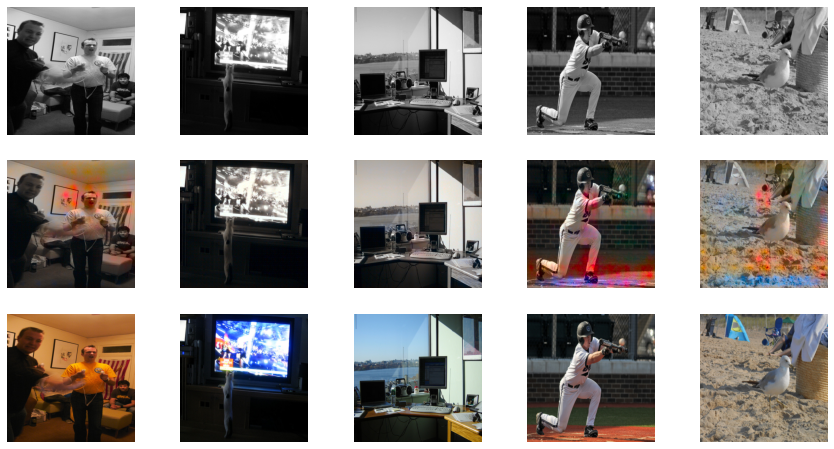

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 3/60
Iteration 300/313
loss_D_fake: 0.49691
loss_D_real: 0.53283
loss_D: 0.51487
loss_G_GAN: 1.37157
loss_G_L1: 10.80803
loss_G: 12.17960


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 141 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 411 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1329 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 66 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


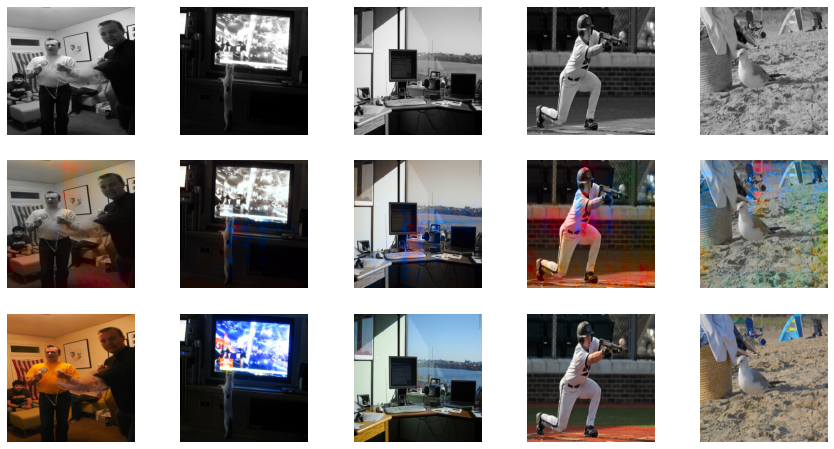

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 4/60
Iteration 300/313
loss_D_fake: 0.48915
loss_D_real: 0.52955
loss_D: 0.50935
loss_G_GAN: 1.39011
loss_G_L1: 10.83545
loss_G: 12.22557


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1111 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1676 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


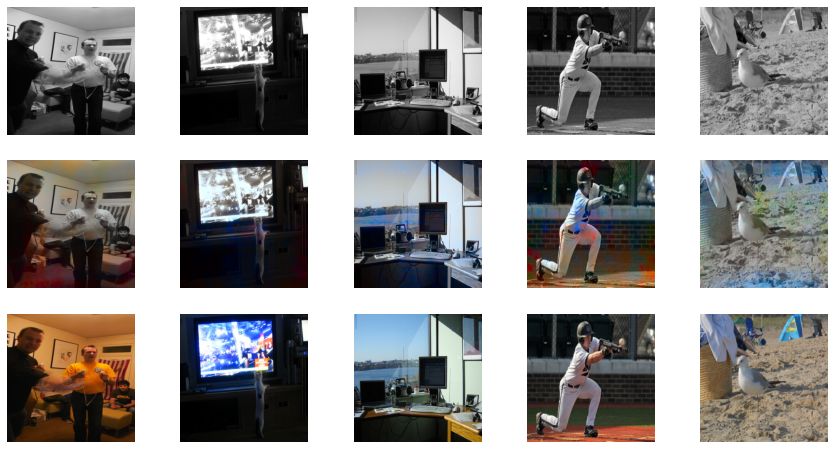

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 5/60
Iteration 300/313
loss_D_fake: 0.49549
loss_D_real: 0.54099
loss_D: 0.51824
loss_G_GAN: 1.36391
loss_G_L1: 10.90212
loss_G: 12.26603


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 107 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 510 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


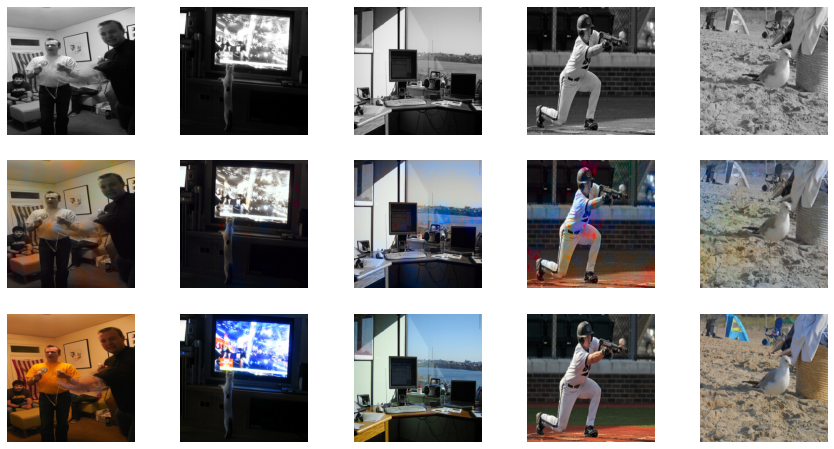

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 6/60
Iteration 300/313
loss_D_fake: 0.50099
loss_D_real: 0.54576
loss_D: 0.52338
loss_G_GAN: 1.35431
loss_G_L1: 10.91911
loss_G: 12.27342


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 35 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 687 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 32 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


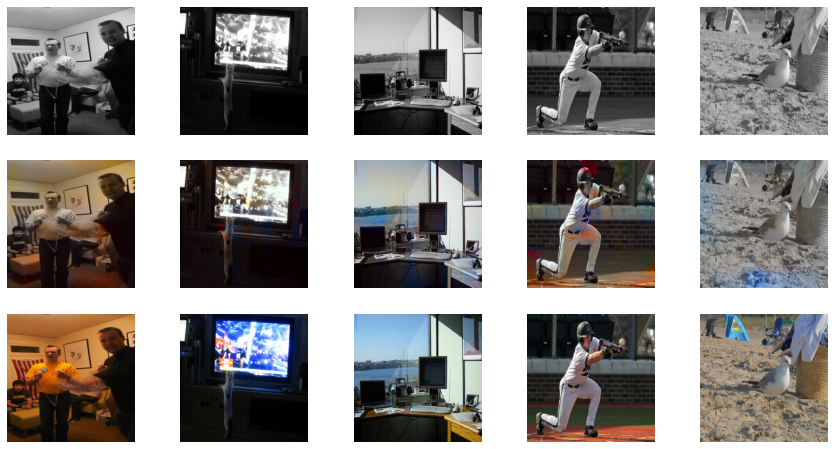

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 7/60
Iteration 300/313
loss_D_fake: 0.49656
loss_D_real: 0.54623
loss_D: 0.52140
loss_G_GAN: 1.34977
loss_G_L1: 10.85918
loss_G: 12.20895


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 444 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 102 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1165 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


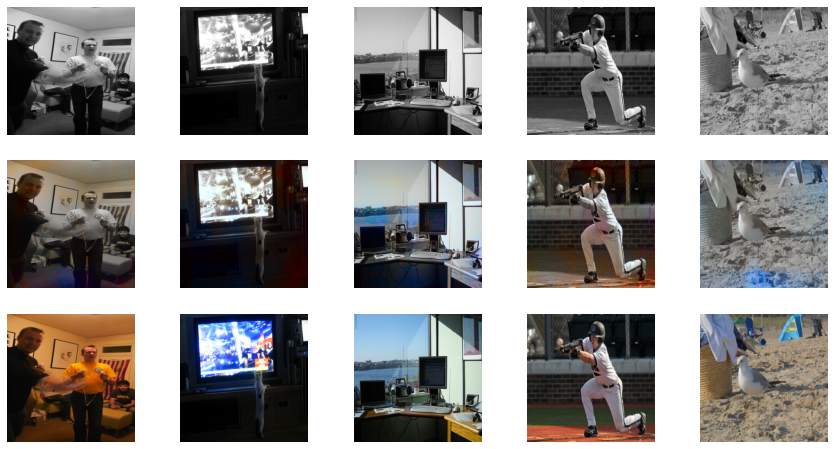

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 8/60
Iteration 300/313
loss_D_fake: 0.49840
loss_D_real: 0.54452
loss_D: 0.52146
loss_G_GAN: 1.35069
loss_G_L1: 10.80762
loss_G: 12.15832


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 309 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


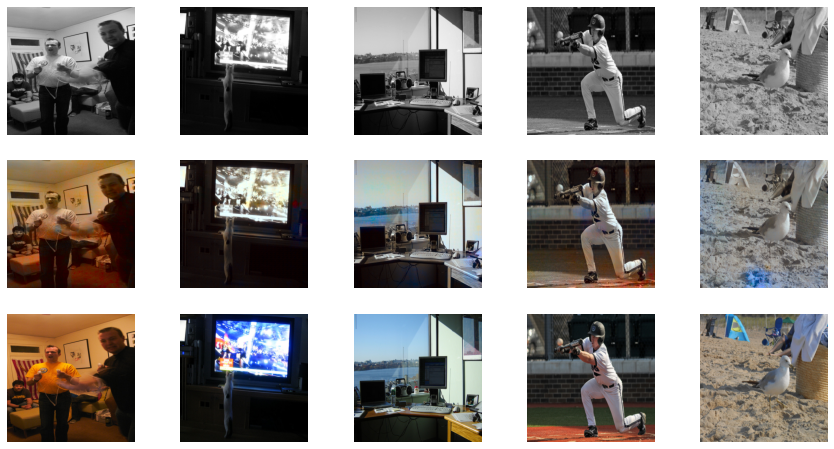

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 9/60
Iteration 300/313
loss_D_fake: 0.49303
loss_D_real: 0.53347
loss_D: 0.51325
loss_G_GAN: 1.37131
loss_G_L1: 10.74657
loss_G: 12.11788


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 59 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


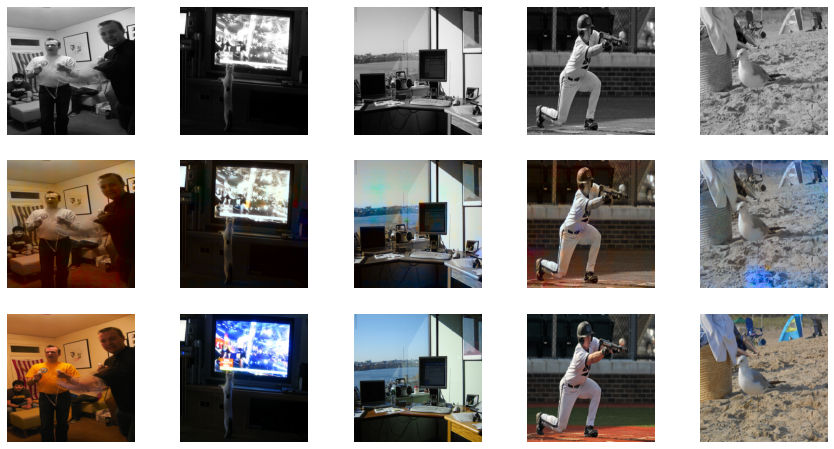

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 10/60
Iteration 300/313
loss_D_fake: 0.47777
loss_D_real: 0.51085
loss_D: 0.49431
loss_G_GAN: 1.44350
loss_G_L1: 10.71918
loss_G: 12.16268


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


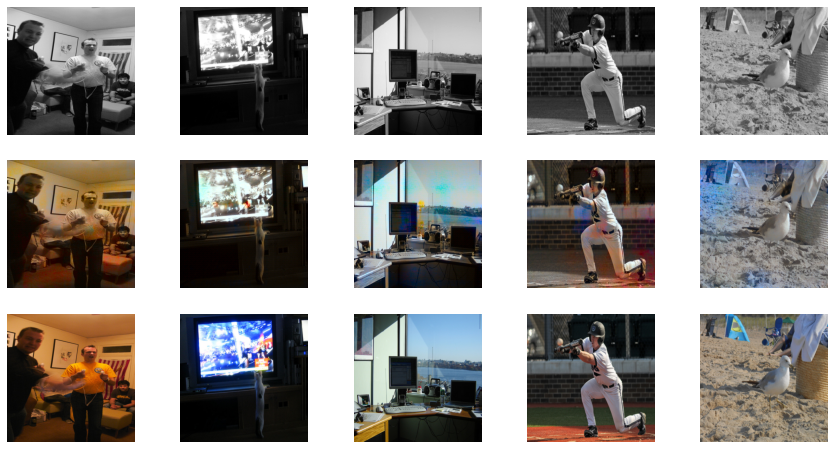

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 11/60
Iteration 300/313
loss_D_fake: 0.44363
loss_D_real: 0.46685
loss_D: 0.45524
loss_G_GAN: 1.60323
loss_G_L1: 10.66050
loss_G: 12.26373


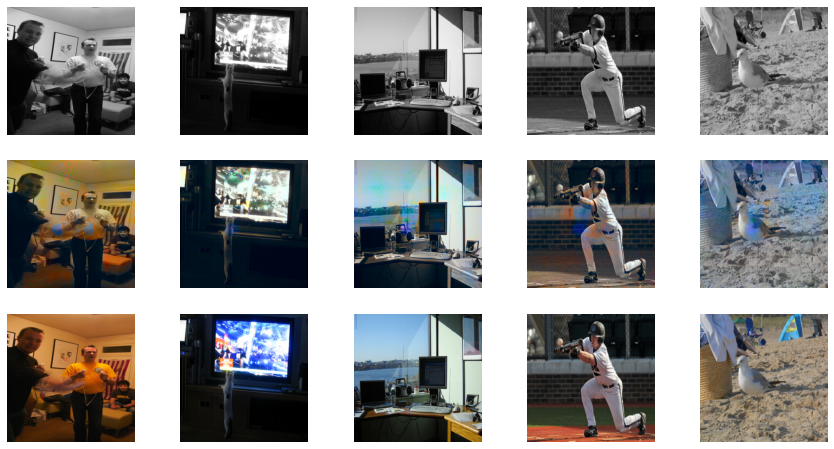

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 12/60
Iteration 300/313
loss_D_fake: 0.41313
loss_D_real: 0.43387
loss_D: 0.42350
loss_G_GAN: 1.78072
loss_G_L1: 10.67737
loss_G: 12.45809


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


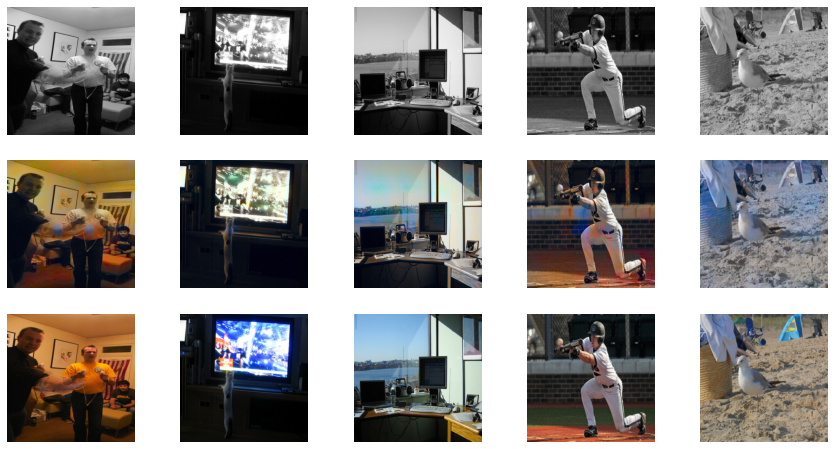

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 13/60
Iteration 300/313
loss_D_fake: 0.36085
loss_D_real: 0.37878
loss_D: 0.36982
loss_G_GAN: 1.99231
loss_G_L1: 10.61143
loss_G: 12.60373


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


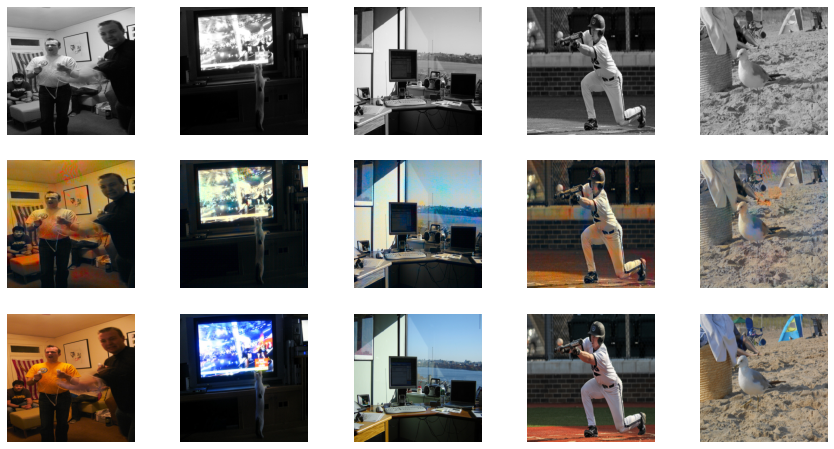

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 14/60
Iteration 300/313
loss_D_fake: 0.34854
loss_D_real: 0.35036
loss_D: 0.34945
loss_G_GAN: 2.12863
loss_G_L1: 10.56574
loss_G: 12.69436


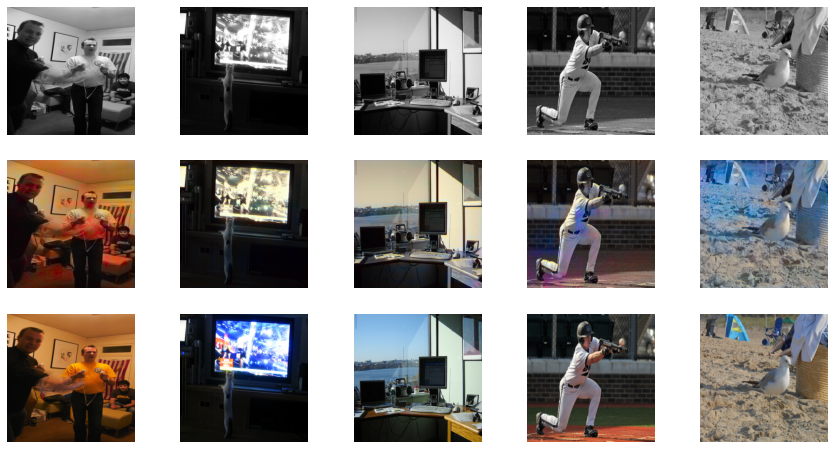

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 15/60
Iteration 300/313
loss_D_fake: 0.30502
loss_D_real: 0.31042
loss_D: 0.30772
loss_G_GAN: 2.36609
loss_G_L1: 10.53090
loss_G: 12.89698


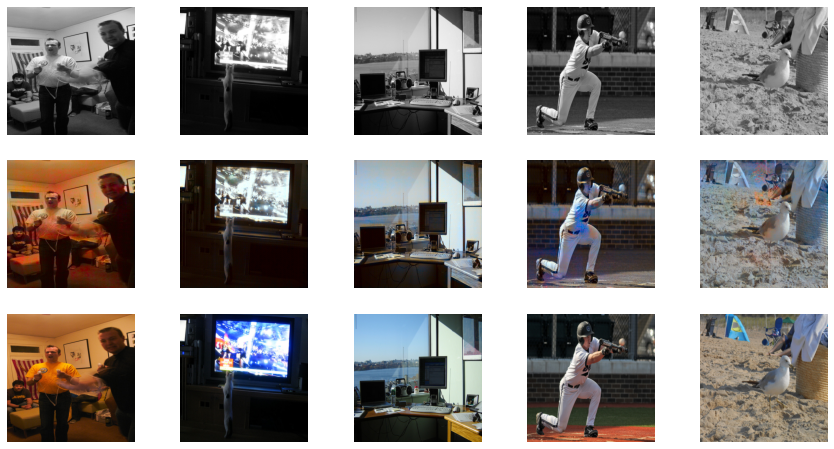

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 16/60
Iteration 300/313
loss_D_fake: 0.28921
loss_D_real: 0.28539
loss_D: 0.28730
loss_G_GAN: 2.52574
loss_G_L1: 10.40409
loss_G: 12.92982


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 65 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 39 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


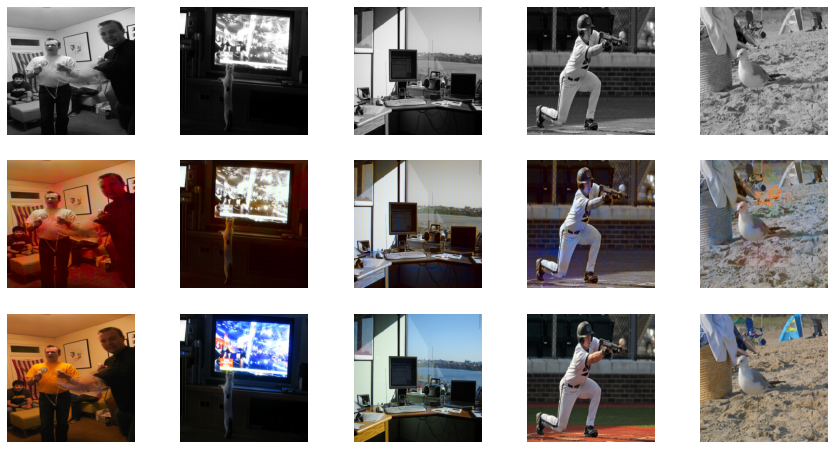

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 17/60
Iteration 300/313
loss_D_fake: 0.30634
loss_D_real: 0.29365
loss_D: 0.29999
loss_G_GAN: 2.62286
loss_G_L1: 10.36407
loss_G: 12.98692


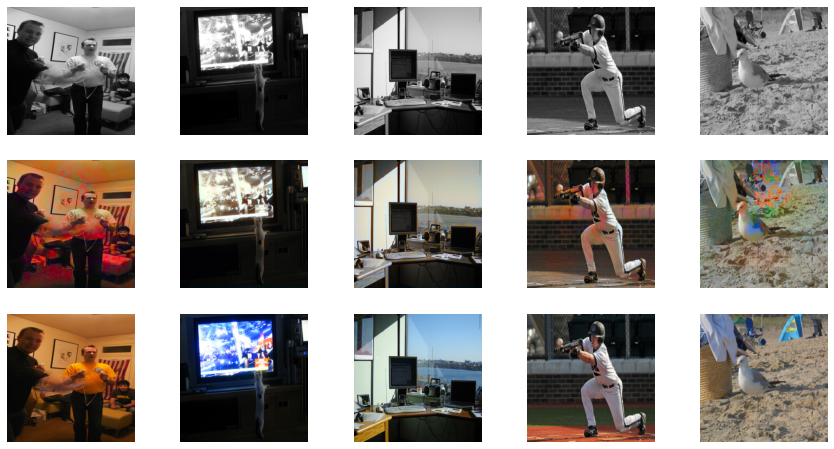

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch 18/60
Iteration 300/313
loss_D_fake: 0.25195
loss_D_real: 0.27252
loss_D: 0.26224
loss_G_GAN: 2.73081
loss_G_L1: 10.22231
loss_G: 12.95312


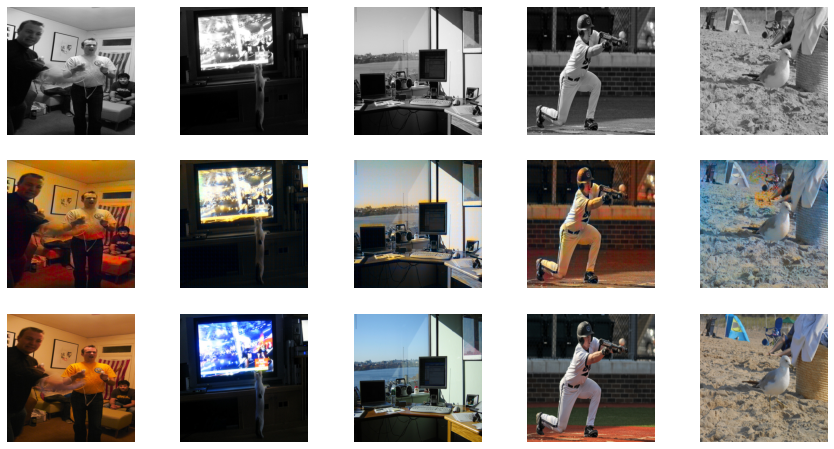

  0%|          | 0/313 [00:00<?, ?it/s]

In [ ]:
model_pix = MainModel_pix()
train_model(model_pix,"pix_mod" ,train_dl)

In [ ]:
model_more_conv = MainModel(net_G = init_model(Unet_more_conv(input_c=1, output_c=2, n_down=8, num_filters=64), device))
train_model(model_more_conv, "model_more_conv" , train_dl)

In [ ]:
model_more_conv_both = MainModel(net_G = init_model(Unet_more_conv_both(input_c=1, output_c=2, n_down=8, num_filters=64), device))
print(model_more_conv_both )
train_model(model_more_conv_both, "model_more_conv_both" , train_dl)

In [ ]:
model_mega_conv = MainModel(net_G = init_model(Unet_mega_conv(input_c=1, output_c=2, n_down=8, num_filters=64), device))
print(model_mega_conv)
train_model(model_mega_conv, "model_megaconv", train_dl)

In [ ]:
def train_model_mod(model, train_dl, epochs, display_every=200, start = 0.2, end = 0.8): #modify the split between the loss calculations
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        rate_change = (end-start)/epochs
        for data in tqdm(train_dl):
            model.setup_input(data) 
            loss_split = start+(i*rate_change)
            model.optimize(loss_split)
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                show_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model_mod = MainModel(net_G = init_model(Unet_more_conv(input_c=1, output_c=2, n_down=8, num_filters=64), device))
print(model_mod )
train_model_mod(model_mod  , train_dl, 20)
torch.save(model_mod  .state_dict(), "model_mod_20.pt")

In [ ]:
model_pix_shuf = MainModel(net_G = init_model(Unet_pixel_shuf_layer(input_c=1, output_c=2, n_down=8, num_filters=64), device))
print(model_pix_shuf )
train_model(model_pix_shuf , train_dl, 20)
torch.save(model_pix_shuf .state_dict(), "model_pix_shuf_20.pt")

### Stuff for report
This section generates some of the stuff used in the report 



In [ ]:
#Get all saved versions of the model and create a csv of their validation over epochs 

def valOverEpoch(model, model_name, getDiscriminatorLoss = True, display_every = 312):

    #check if model is in folder, if so load most trained version of the model
    dict_name = model_name + "_stdict"
    descr_len = len(dict_name) + 1

    dirs = os.listdir(Drive_path)
    model_saves = []
    for p in dirs:
      if dict_name in p:
        completed_epochs = int(p[descr_len:])
        model_saves.append((completed_epochs,p))
    
    if model_saves:
      model_saves = sorted(model_saves)

    #if no saved model is found  
    else:
      print("found no model --- thus nothing to graph")
      return
    print(model_saves) 
    
    for (x,model_path) in model_saves:
        #load state dict into model
        model.load_state_dict(torch.load(Drive_path+"/"+model_path))
        #set to eval mode
        model.eval()

        #run validation though model
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        if getDiscriminatorLoss == False:
          loss_meter_dict = create_loss_meters_nodiscrim()
        i = 0                                  # log the losses of the complete network
        for data_v in tqdm(val_dl):
            model.setup_input(data_v) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {model_path}")
                show_results(loss_meter_dict) # function to print out the losses
                visualize(model, data_v, save=False) # function displaying the model's outputs
        
        #log the loss for the epoch
        csv_entry = [str(x), model_name]
        if getDiscriminatorLoss == False:
          csv_entry = [str(x), model_name, '0','0','0','0','0']
        for loss_name, loss_meter in loss_meter_dict.items():
          csv_entry.append(str(loss_meter.avg))
        with open(Drive_path + "/" + "model_val.csv", 'a') as f:
          f.write(','.join(csv_entry))
          f.write('\n')

model initialized with norm initialization
model initialized with norm initialization
[(10, 'model1_stdict_10'), (20, 'model1_stdict_20'), (30, 'model1_stdict_30'), (40, 'model1_stdict_40'), (50, 'model1_stdict_50'), (60, 'model1_stdict_60')]


  0%|          | 0/313 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))



Epoch model1_stdict_10
loss_D_fake: 0.37639
loss_D_real: 0.40892
loss_D: 0.39266
loss_G_GAN: 1.89991
loss_G_L1: 11.61265
loss_G: 13.51257


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 230 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 60 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

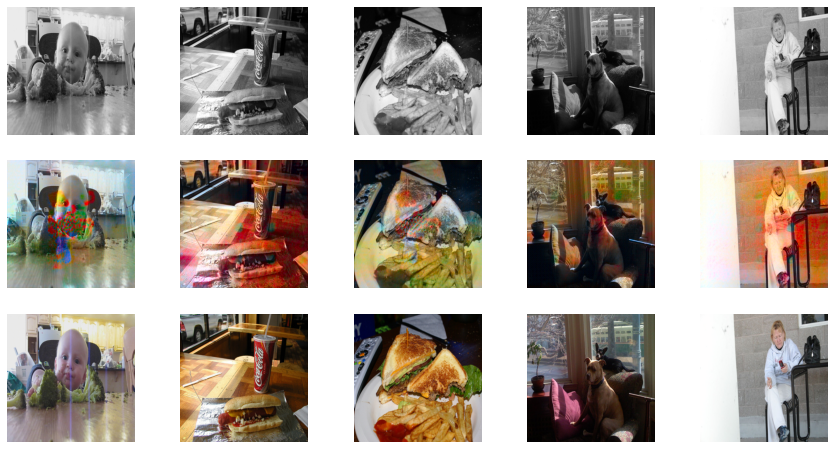

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model1_stdict_20
loss_D_fake: 0.27750
loss_D_real: 0.26877
loss_D: 0.27314
loss_G_GAN: 2.81857
loss_G_L1: 11.51421
loss_G: 14.33279


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 125 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 410 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

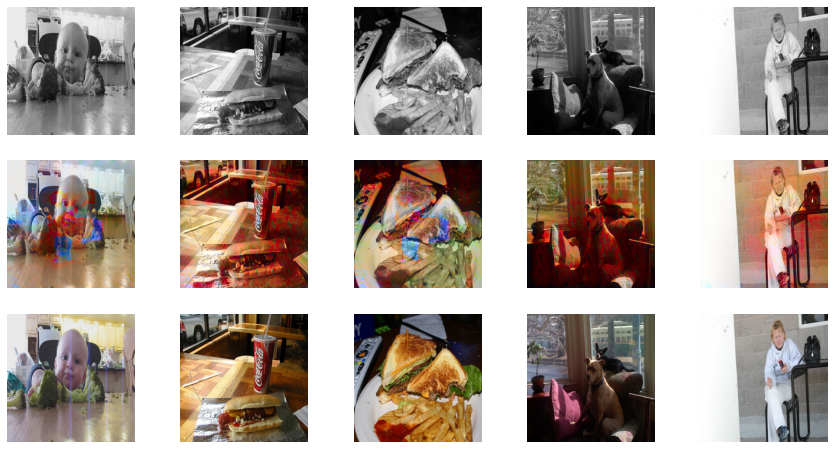

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model1_stdict_30
loss_D_fake: 0.24222
loss_D_real: 0.23625
loss_D: 0.23923
loss_G_GAN: 3.81551
loss_G_L1: 11.42335
loss_G: 15.23886


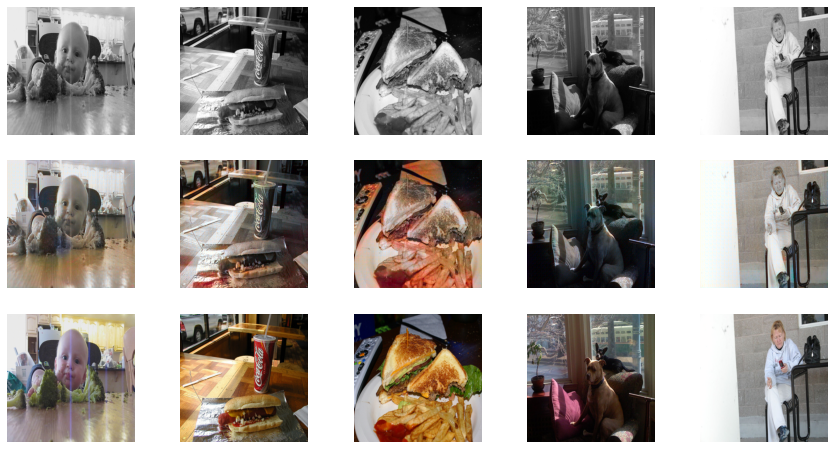

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model1_stdict_40
loss_D_fake: 0.18775
loss_D_real: 0.18424
loss_D: 0.18600
loss_G_GAN: 4.16808
loss_G_L1: 11.33642
loss_G: 15.50450


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 93 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

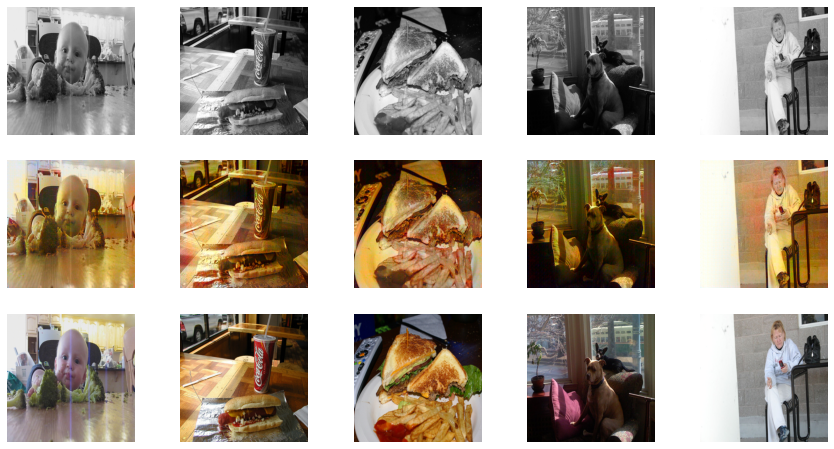

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model1_stdict_50
loss_D_fake: 0.17765
loss_D_real: 0.17789
loss_D: 0.17777
loss_G_GAN: 4.70963
loss_G_L1: 11.40396
loss_G: 16.11358


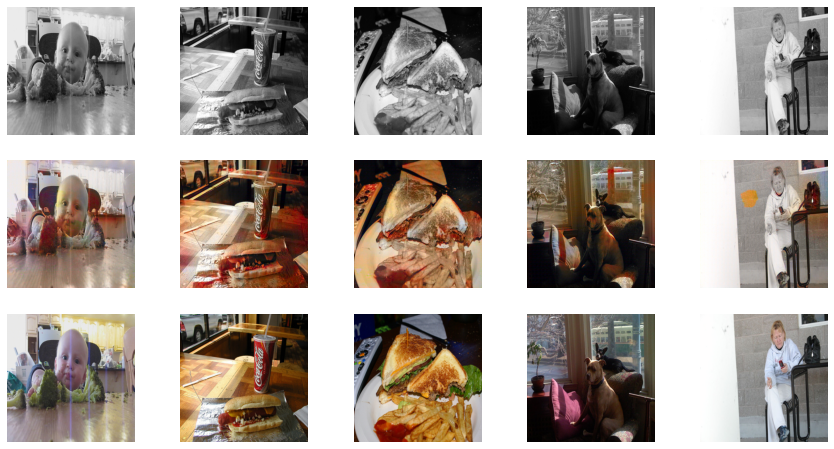

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model1_stdict_60
loss_D_fake: 0.05504
loss_D_real: 0.05957
loss_D: 0.05731
loss_G_GAN: 4.67870
loss_G_L1: 10.92846
loss_G: 15.60715


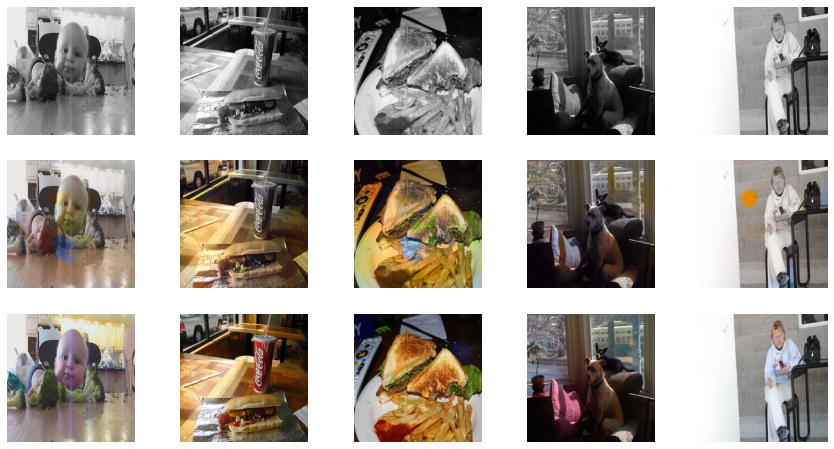

In [ ]:
valOverEpoch(MainModel(),"model1")

model initialized with norm initialization
model initialized with norm initialization
[(10, 'model_more_conv_stdict_10'), (20, 'model_more_conv_stdict_20'), (30, 'model_more_conv_stdict_30'), (40, 'model_more_conv_stdict_40'), (50, 'model_more_conv_stdict_50'), (60, 'model_more_conv_stdict_60')]


  0%|          | 0/313 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))



Epoch model_more_conv_stdict_10
loss_D_fake: 0.54594
loss_D_real: 0.61266
loss_D: 0.57930
loss_G_GAN: 1.22193
loss_G_L1: 11.25704
loss_G: 12.47897


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 181 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 643 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 75 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Col

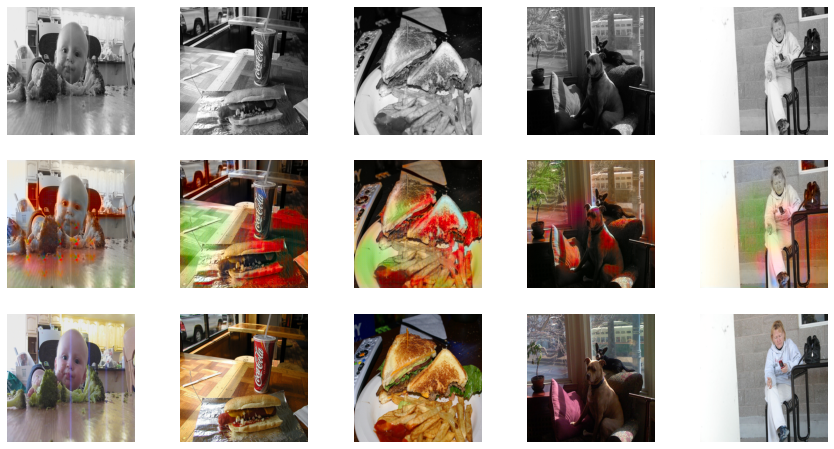

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_stdict_20
loss_D_fake: 0.54033
loss_D_real: 0.60589
loss_D: 0.57311
loss_G_GAN: 1.20978
loss_G_L1: 11.12186
loss_G: 12.33164


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


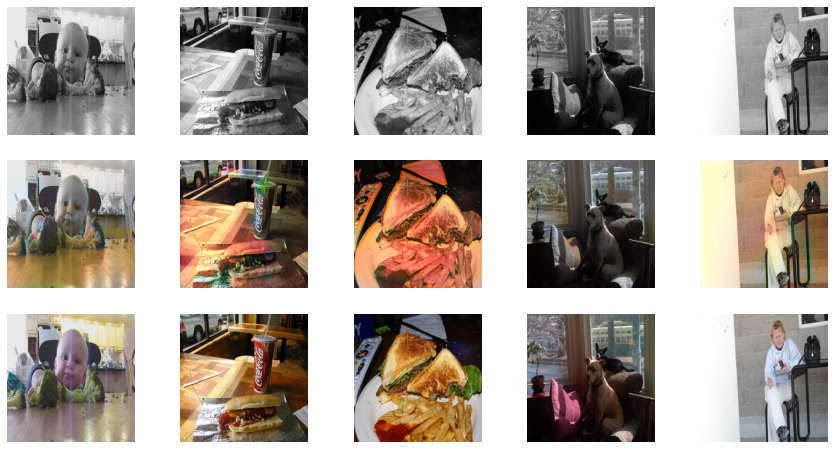

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_stdict_30
loss_D_fake: 0.53552
loss_D_real: 0.60085
loss_D: 0.56819
loss_G_GAN: 1.24099
loss_G_L1: 11.02836
loss_G: 12.26935


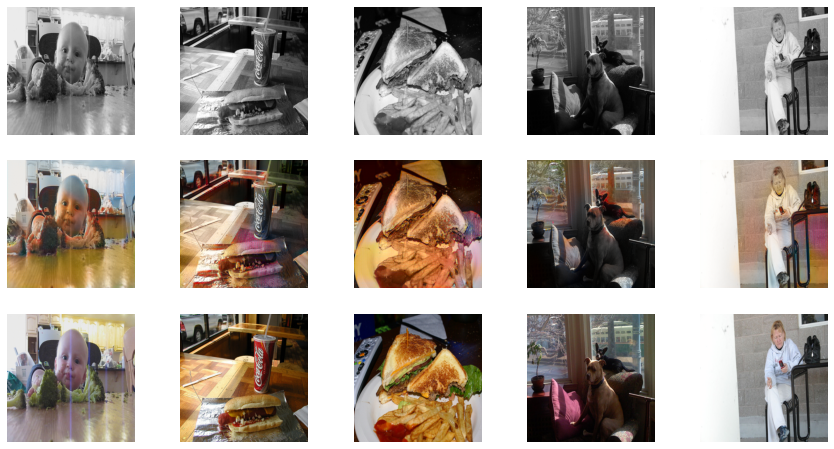

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_stdict_40
loss_D_fake: 0.52765
loss_D_real: 0.58071
loss_D: 0.55418
loss_G_GAN: 1.27977
loss_G_L1: 10.98192
loss_G: 12.26169


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


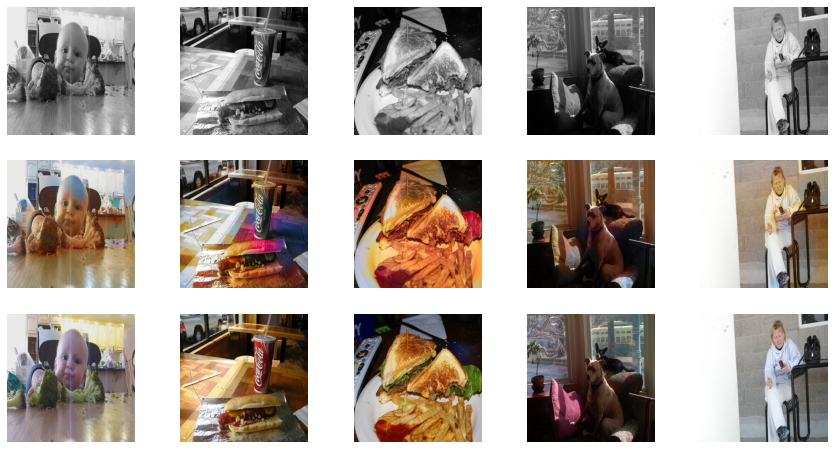

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_stdict_50
loss_D_fake: 0.53023
loss_D_real: 0.58044
loss_D: 0.55534
loss_G_GAN: 1.29582
loss_G_L1: 10.81800
loss_G: 12.11383


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 82 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


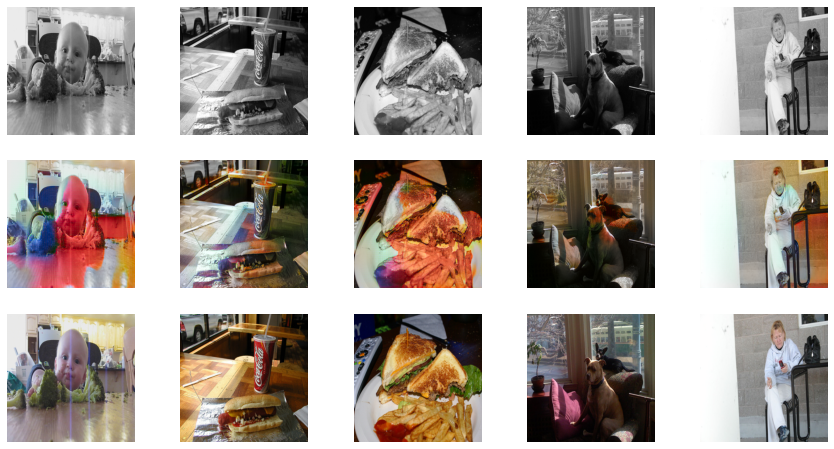

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_stdict_60
loss_D_fake: 0.52569
loss_D_real: 0.55973
loss_D: 0.54271
loss_G_GAN: 1.34605
loss_G_L1: 10.81403
loss_G: 12.16008


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 46 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


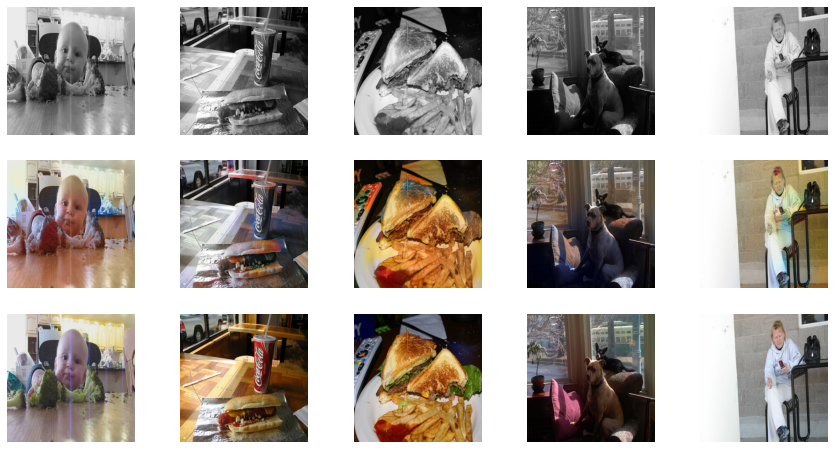

In [ ]:
valOverEpoch(MainModel(net_G = init_model(Unet_more_conv(input_c=1, output_c=2, n_down=8, num_filters=64), device)),"model_more_conv")

model initialized with norm initialization
[(3, 'MOD1_nodiscrim_stdict_3'), (6, 'MOD1_nodiscrim_stdict_6'), (9, 'MOD1_nodiscrim_stdict_9'), (12, 'MOD1_nodiscrim_stdict_12'), (15, 'MOD1_nodiscrim_stdict_15'), (18, 'MOD1_nodiscrim_stdict_18'), (20, 'MOD1_nodiscrim_stdict_20'), (30, 'MOD1_nodiscrim_stdict_30'), (40, 'MOD1_nodiscrim_stdict_40'), (50, 'MOD1_nodiscrim_stdict_50'), (60, 'MOD1_nodiscrim_stdict_60')]


  0%|          | 0/313 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))



Epoch MOD1_nodiscrim_stdict_3
loss_G: 8.51369


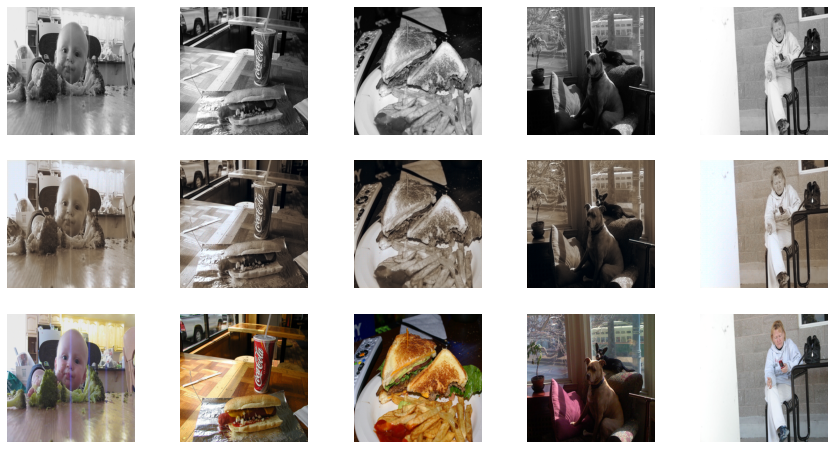

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_6
loss_G: 8.46964


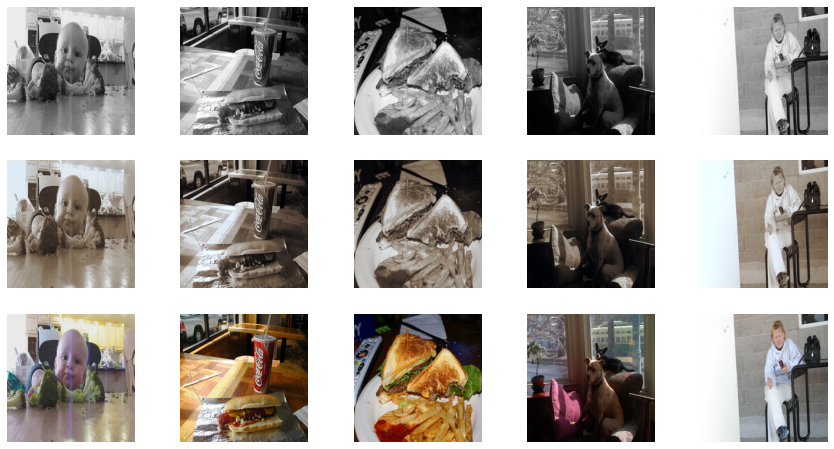

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_9
loss_G: 8.44325


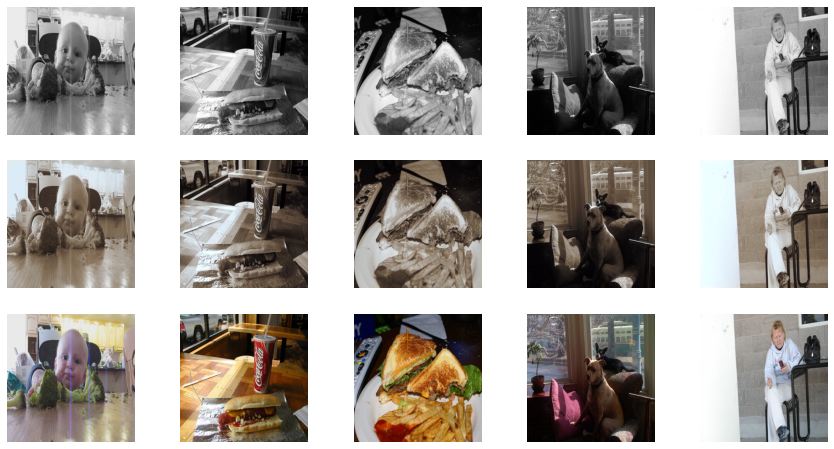

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_12
loss_G: 8.42569


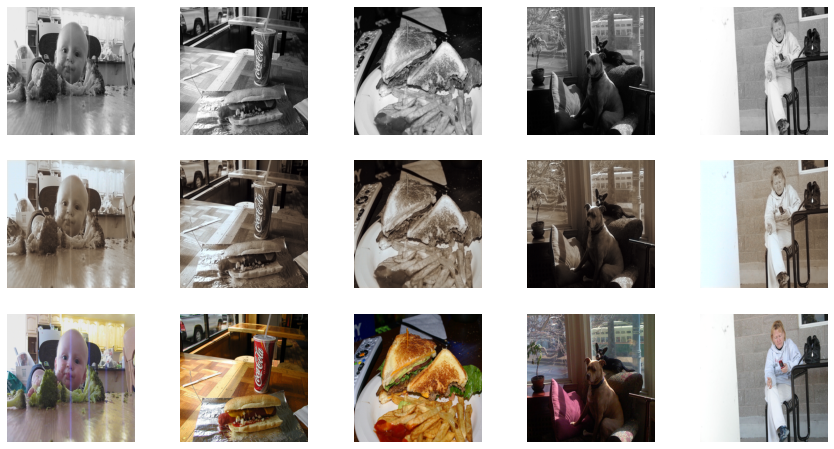

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_15
loss_G: 8.41305


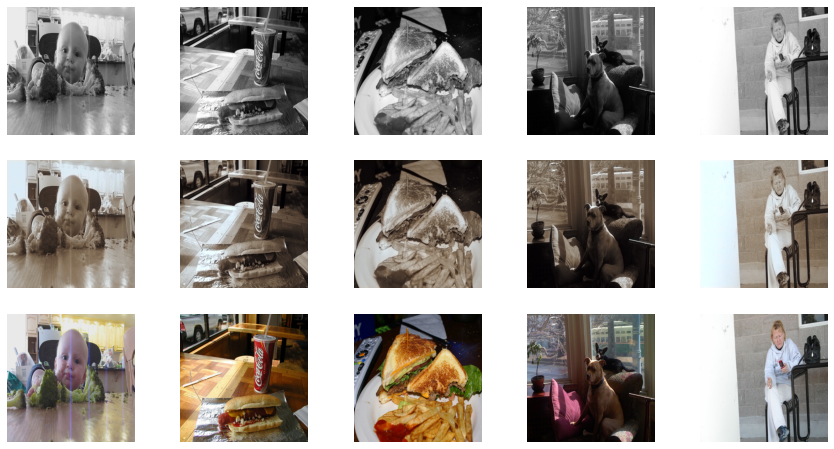

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_18
loss_G: 8.40665


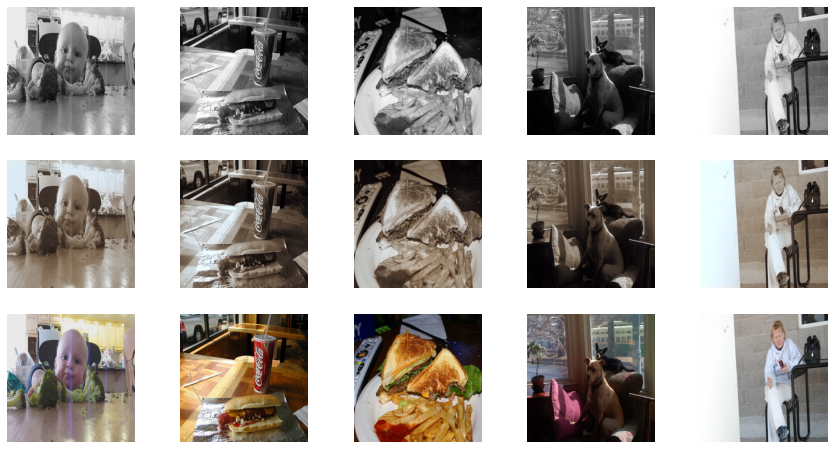

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_20
loss_G: 8.40283


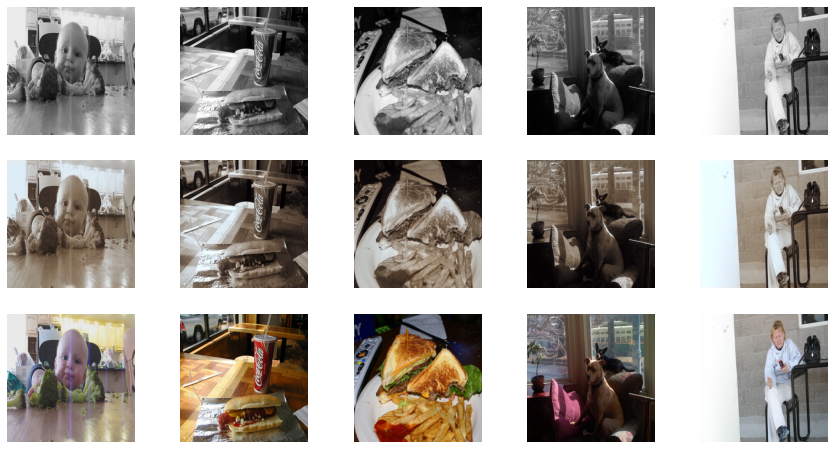

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_30
loss_G: 8.39608


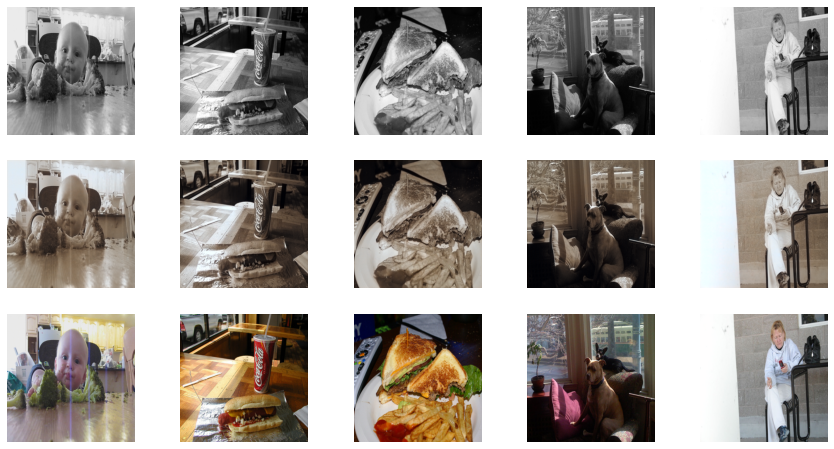

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_40
loss_G: 8.39292


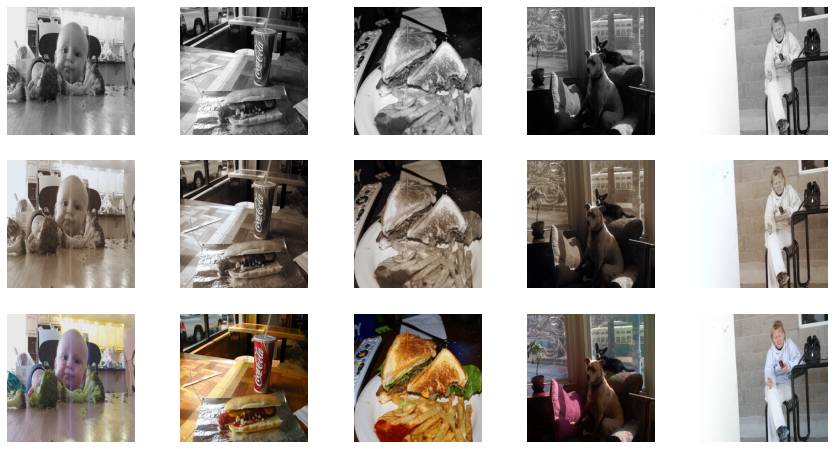

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_50
loss_G: 8.39301


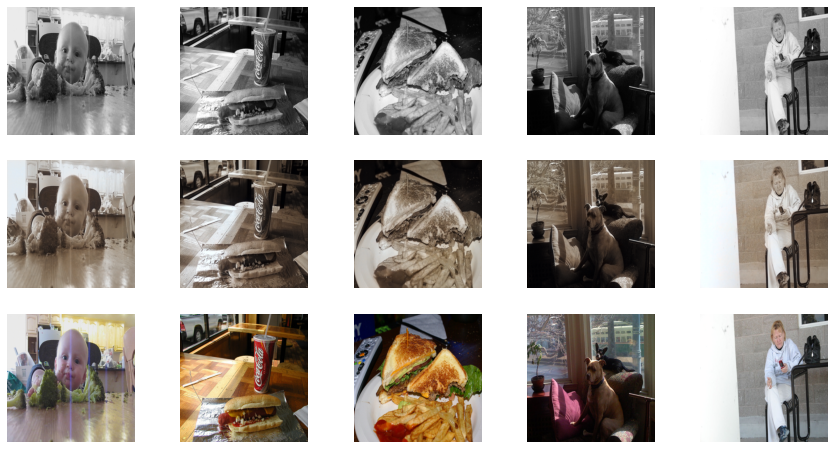

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch MOD1_nodiscrim_stdict_60
loss_G: 8.39039


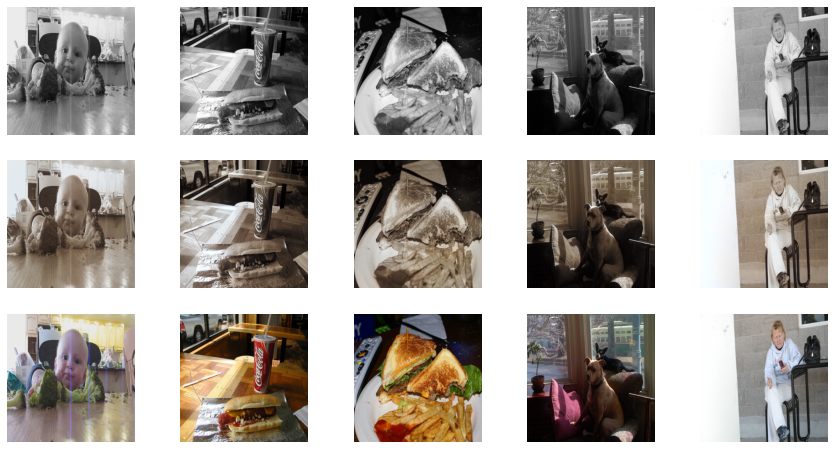

In [ ]:
#simple model, unet with no discrimina
valOverEpoch(MainModelNoDiscrim(),"MOD1_nodiscrim",getDiscriminatorLoss=False)

model initialized with norm initialization
model initialized with norm initialization
[(10, 'model_megaconv_stdict_10'), (20, 'model_megaconv_stdict_20'), (30, 'model_megaconv_stdict_30'), (40, 'model_megaconv_stdict_40'), (50, 'model_megaconv_stdict_50'), (60, 'model_megaconv_stdict_60')]


  0%|          | 0/313 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))



Epoch model_megaconv_stdict_10
loss_D_fake: 0.52780
loss_D_real: 0.58972
loss_D: 0.55876
loss_G_GAN: 1.32467
loss_G_L1: 11.47624
loss_G: 12.80091


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color da

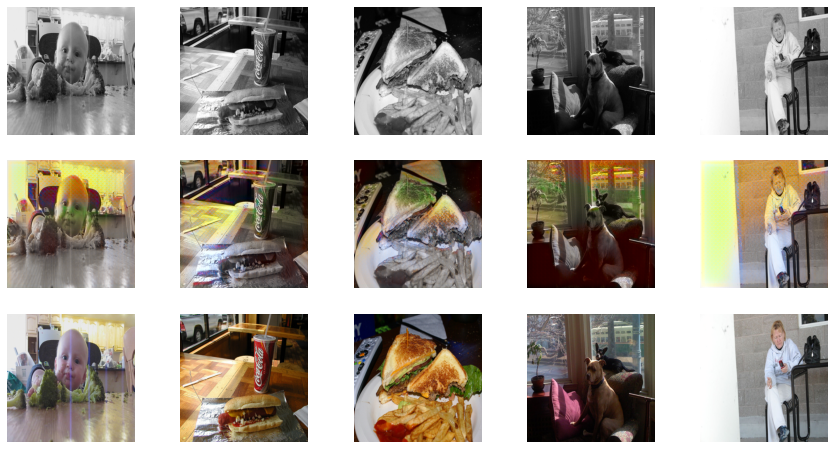

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_megaconv_stdict_20
loss_D_fake: 0.52998
loss_D_real: 0.60295
loss_D: 0.56646
loss_G_GAN: 1.19621
loss_G_L1: 11.38419
loss_G: 12.58041


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


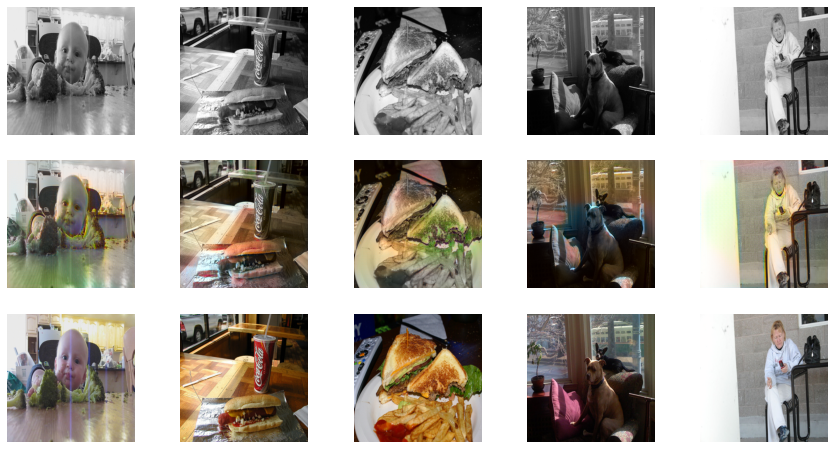

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_megaconv_stdict_30
loss_D_fake: 0.52664
loss_D_real: 0.59423
loss_D: 0.56043
loss_G_GAN: 1.23007
loss_G_L1: 11.33483
loss_G: 12.56490


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


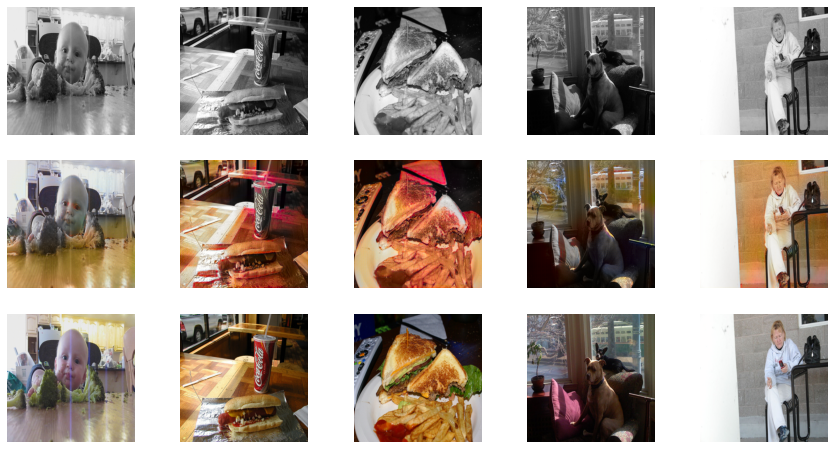

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_megaconv_stdict_40
loss_D_fake: 0.52202
loss_D_real: 0.58961
loss_D: 0.55581
loss_G_GAN: 1.23931
loss_G_L1: 11.15382
loss_G: 12.39313


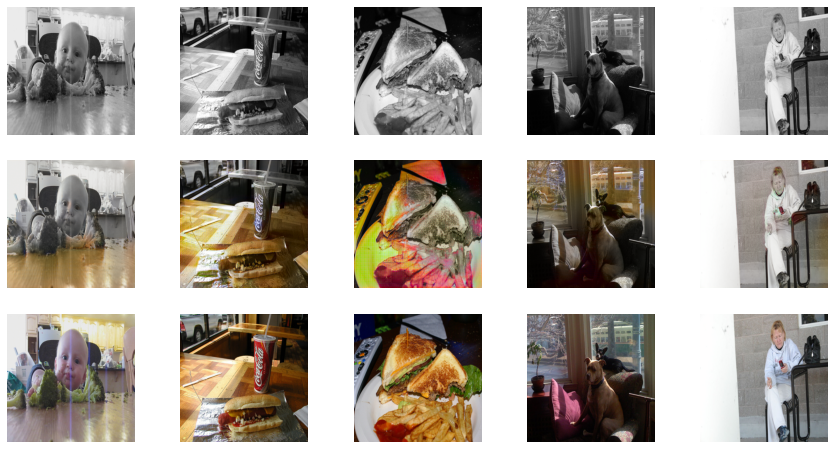

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_megaconv_stdict_50
loss_D_fake: 0.52246
loss_D_real: 0.58340
loss_D: 0.55293
loss_G_GAN: 1.28931
loss_G_L1: 11.16667
loss_G: 12.45597


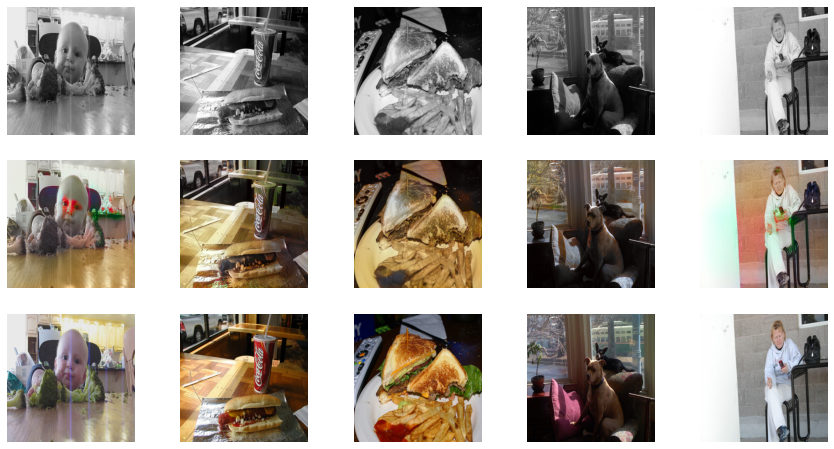

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_megaconv_stdict_60
loss_D_fake: 0.51291
loss_D_real: 0.57981
loss_D: 0.54636
loss_G_GAN: 1.30986
loss_G_L1: 11.03502
loss_G: 12.34488


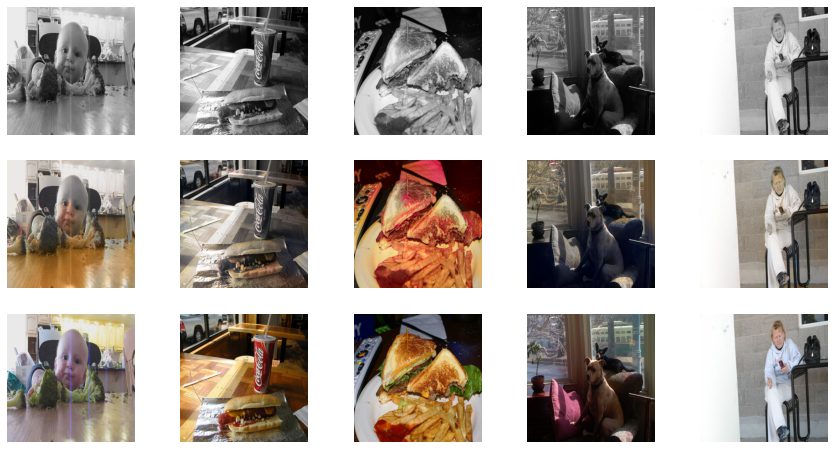

In [ ]:
valOverEpoch(MainModel(net_G = init_model(Unet_mega_conv(input_c=1, output_c=2, n_down=8, num_filters=64), device)),"model_megaconv")

model initialized with norm initialization
model initialized with norm initialization
[(10, 'model_more_conv_both_stdict_10'), (20, 'model_more_conv_both_stdict_20'), (30, 'model_more_conv_both_stdict_30'), (40, 'model_more_conv_both_stdict_40'), (50, 'model_more_conv_both_stdict_50'), (60, 'model_more_conv_both_stdict_60')]


  0%|          | 0/313 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))



Epoch model_more_conv_both_stdict_10
loss_D_fake: 0.51969
loss_D_real: 0.58130
loss_D: 0.55050
loss_G_GAN: 1.36112
loss_G_L1: 11.50776
loss_G: 12.86888


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color dat

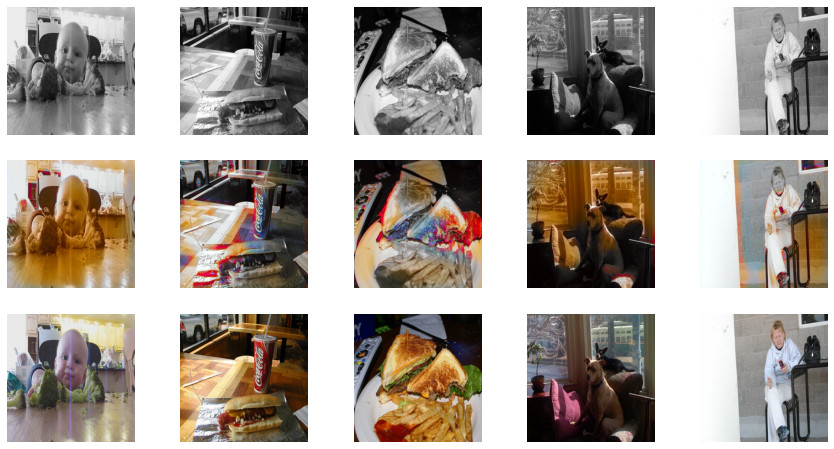

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_both_stdict_20
loss_D_fake: 0.52373
loss_D_real: 0.60679
loss_D: 0.56526
loss_G_GAN: 1.27316
loss_G_L1: 11.48710
loss_G: 12.76026


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


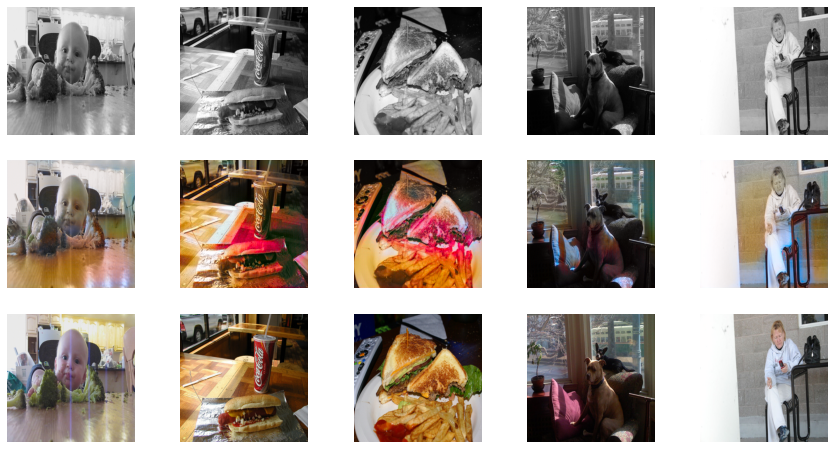

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_both_stdict_30
loss_D_fake: 0.51285
loss_D_real: 0.57376
loss_D: 0.54331
loss_G_GAN: 1.32297
loss_G_L1: 11.34561
loss_G: 12.66857


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


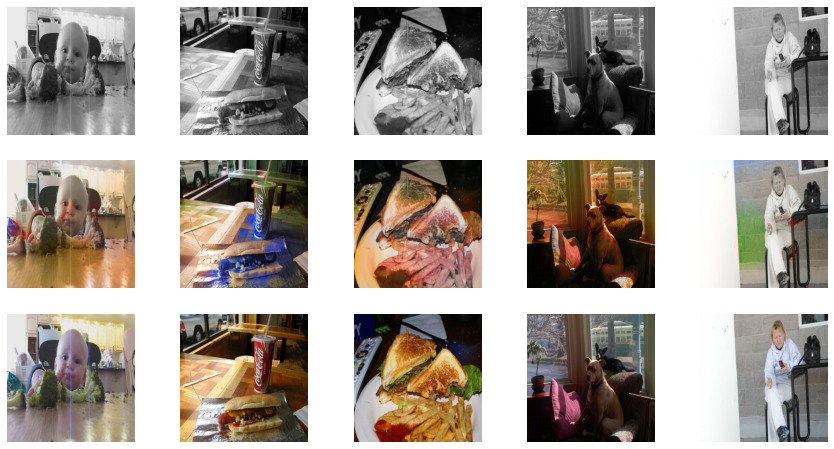

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_both_stdict_40
loss_D_fake: 0.51751
loss_D_real: 0.57501
loss_D: 0.54626
loss_G_GAN: 1.37902
loss_G_L1: 11.22964
loss_G: 12.60866


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


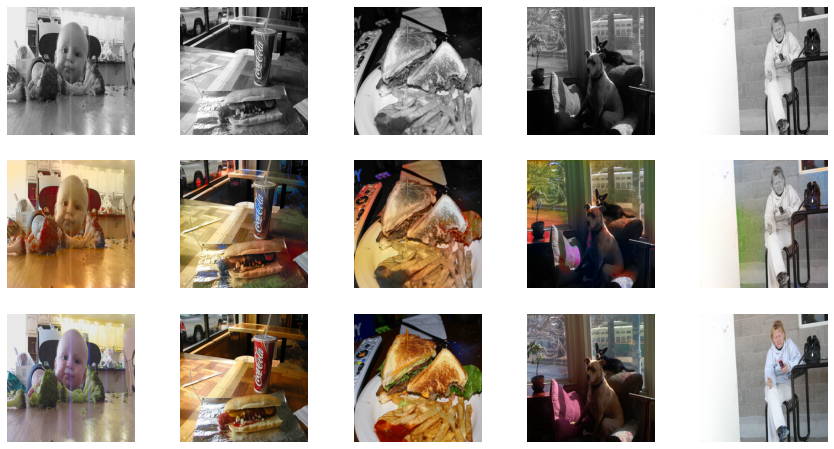

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_both_stdict_50
loss_D_fake: 0.52282
loss_D_real: 0.57809
loss_D: 0.55045
loss_G_GAN: 1.36646
loss_G_L1: 11.13654
loss_G: 12.50299


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


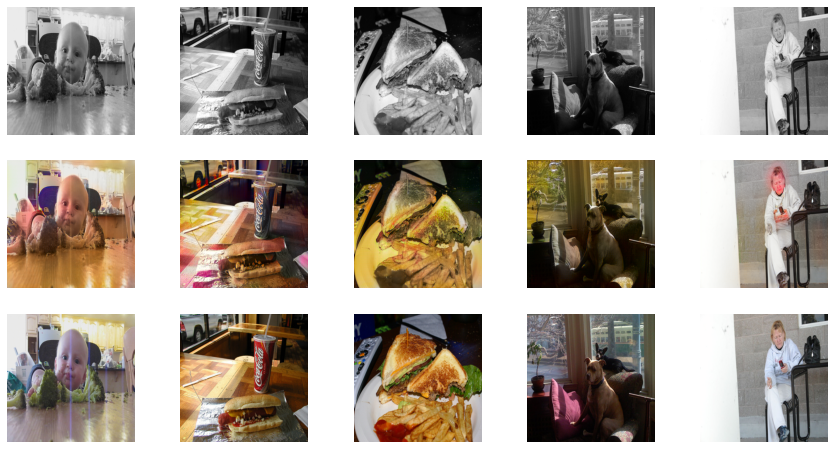

  0%|          | 0/313 [00:00<?, ?it/s]


Epoch model_more_conv_both_stdict_60
loss_D_fake: 0.51943
loss_D_real: 0.57146
loss_D: 0.54545
loss_G_GAN: 1.41083
loss_G_L1: 11.09093
loss_G: 12.50176


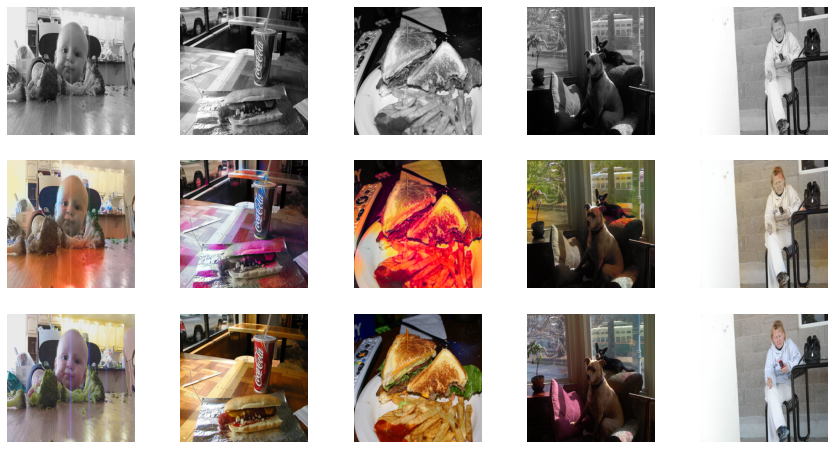

In [ ]:
valOverEpoch(MainModel(net_G = init_model(Unet_more_conv_both(input_c=1, output_c=2, n_down=8, num_filters=64), device)),"model_more_conv_both")